There are several examples in this notebook:

1. Augmentation using Augraphy default pipeline.
2. Augmentation using user defined pipeline.
3. Augmentation using batches of images (List).
4. Augmentation using batches of images (4D image array).
5. Augmentation using archetype pipelines (predefined pipeline).
6. Augmentation with additional inputs such as mask, keypoints and bounding boxes.

In [1]:
# install Augraphy

!pip install git+https://github.com/sparkfish/augraphy

  Cloning https://github.com/sparkfish/augraphy to /tmp/pip-req-build-y_wfut_f
  Running command git clone --filter=blob:none --quiet https://github.com/sparkfish/augraphy /tmp/pip-req-build-y_wfut_f
  Resolved https://github.com/sparkfish/augraphy to commit 9e668397f8128f7af04e4f8819646c3b1d4078d6
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 45.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 MB 13.8 MB/s eta 0:00:00
  Created wheel for augraphy: filename=augraphy-8.2.4-py3-none-any.whl size=192875 sha256=14cdf28bd592a09e7697c39a8f8b1d7aec42da5625fd236f4bc197bf199effb1
  Stored in directory: /tmp/pip-ephem-wheel-cache-5xs5wkye/wheels/36/d0/21/1aa9ab43fc6934decc10b8a3b839a472b0fed7d3d185b90d51
Successfully built augraphy
  Attempting uninstall: llvmlite
    Found existing installation: llvmlite 0.39.1
    Uninstalli

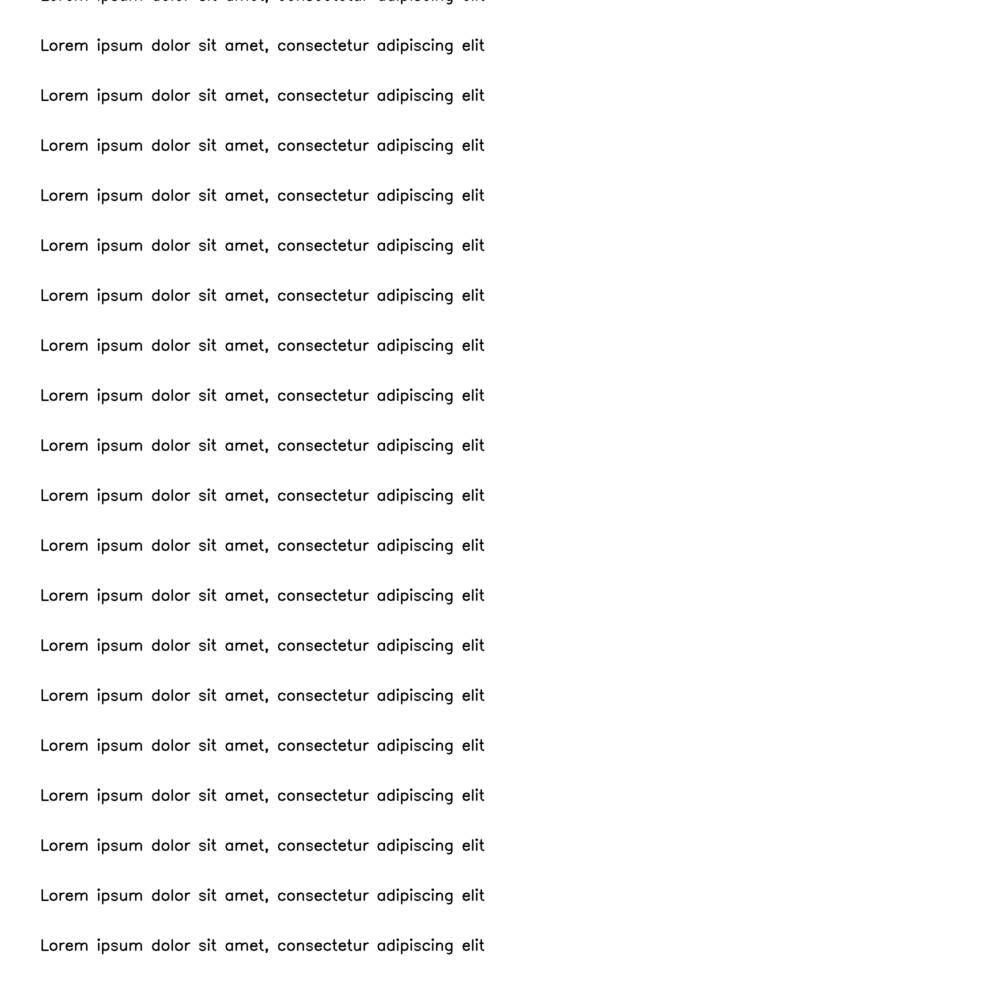

In [2]:
# create an image

import numpy as np
import cv2
from google.colab.patches import cv2_imshow

image = np.full((2000, 2000, 3), 255, dtype="uint8")
for i in range(20):

    font_size = 1
    thickness=2

    cv2.putText(
        image,
        "Lorem ipsum dolor sit amet, consectetur adipiscing elit",
        (80, i*100),
        cv2.FONT_HERSHEY_SIMPLEX,
        font_size,
        0,
        thickness,
    )

# display image
cv2_imshow(image)

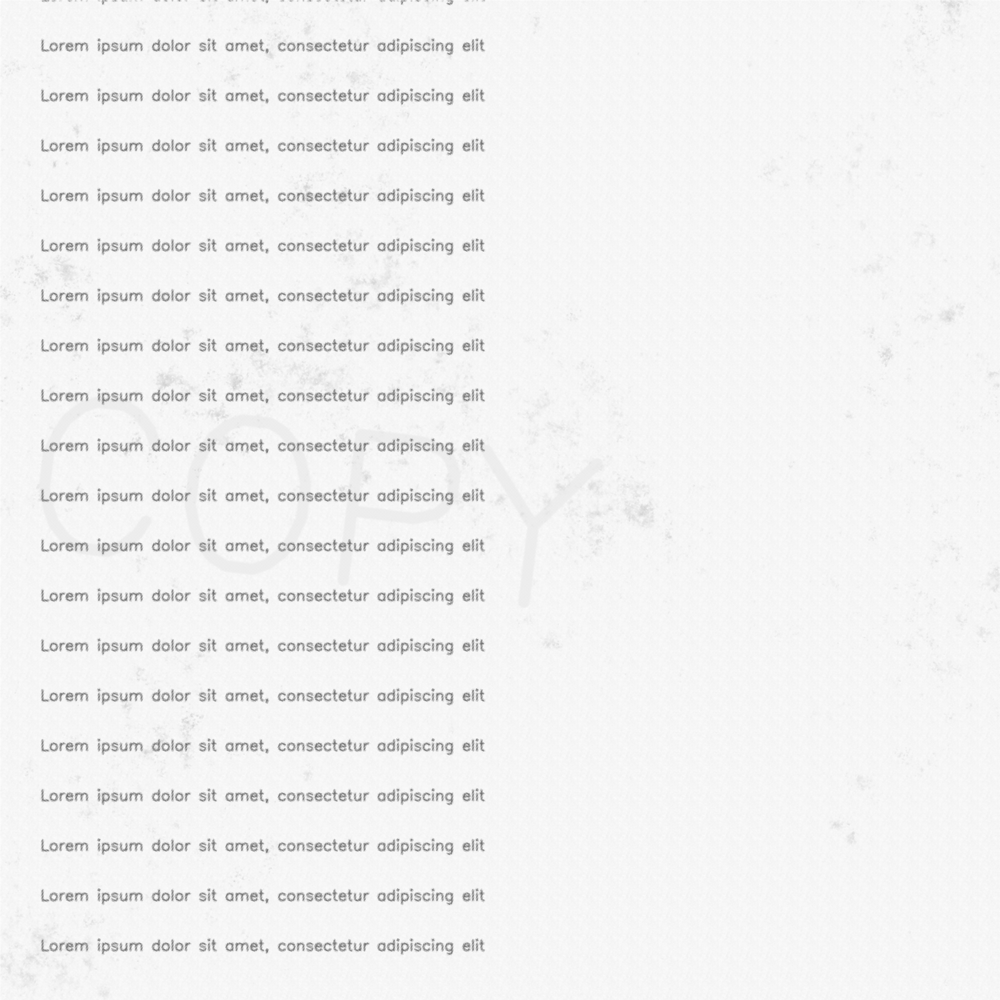

In [ ]:
# 1. Augmentation using Augraphy default pipeline.

from augraphy import *

pipeline = default_augraphy_pipeline()

image_augmented = pipeline(image)

# display image
cv2_imshow(image_augmented)


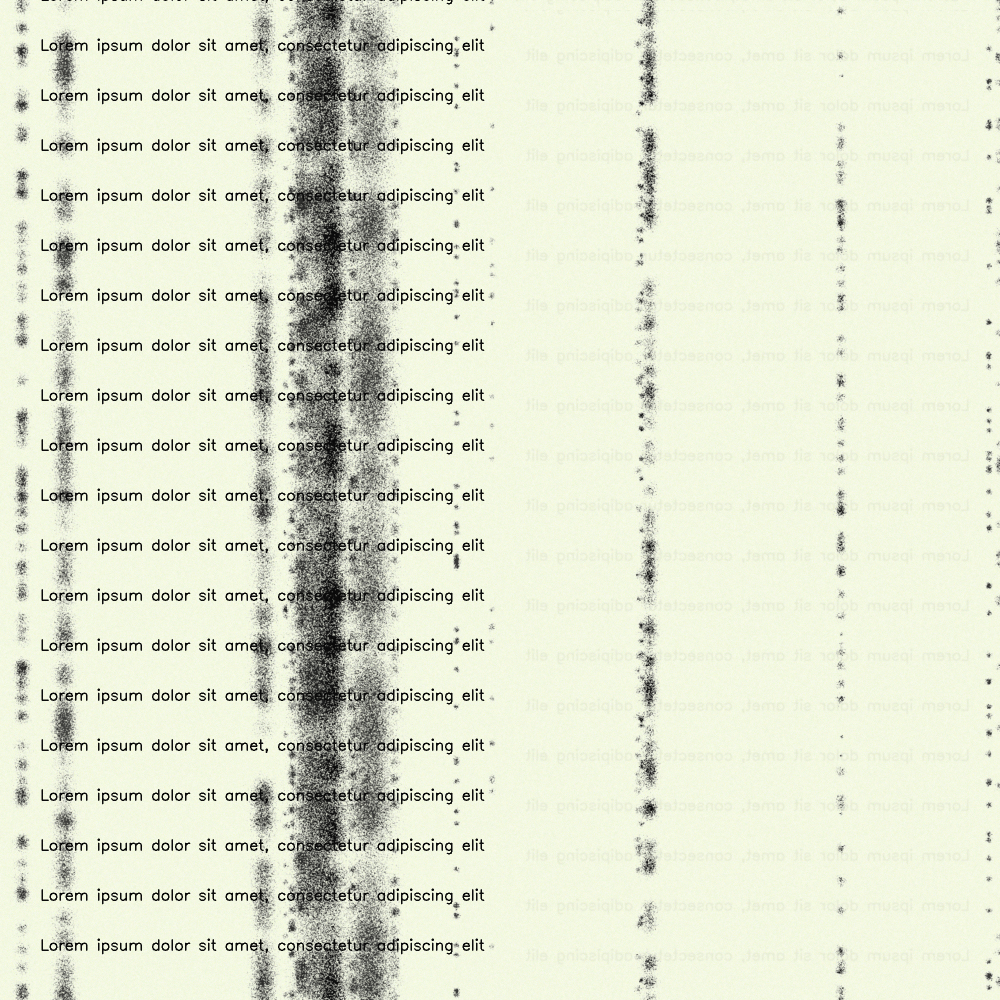

In [ ]:
# 2. Augmentation using user defined pipeline.

from augraphy import *

ink_phase = [DirtyDrum()]
paper_phase = [ColorPaper()]
post_phase = [BleedThrough()]

pipeline = AugraphyPipeline(ink_phase=ink_phase, paper_phase=paper_phase, post_phase=post_phase)

image_augmented = pipeline(image)

# display image
cv2_imshow(image_augmented)

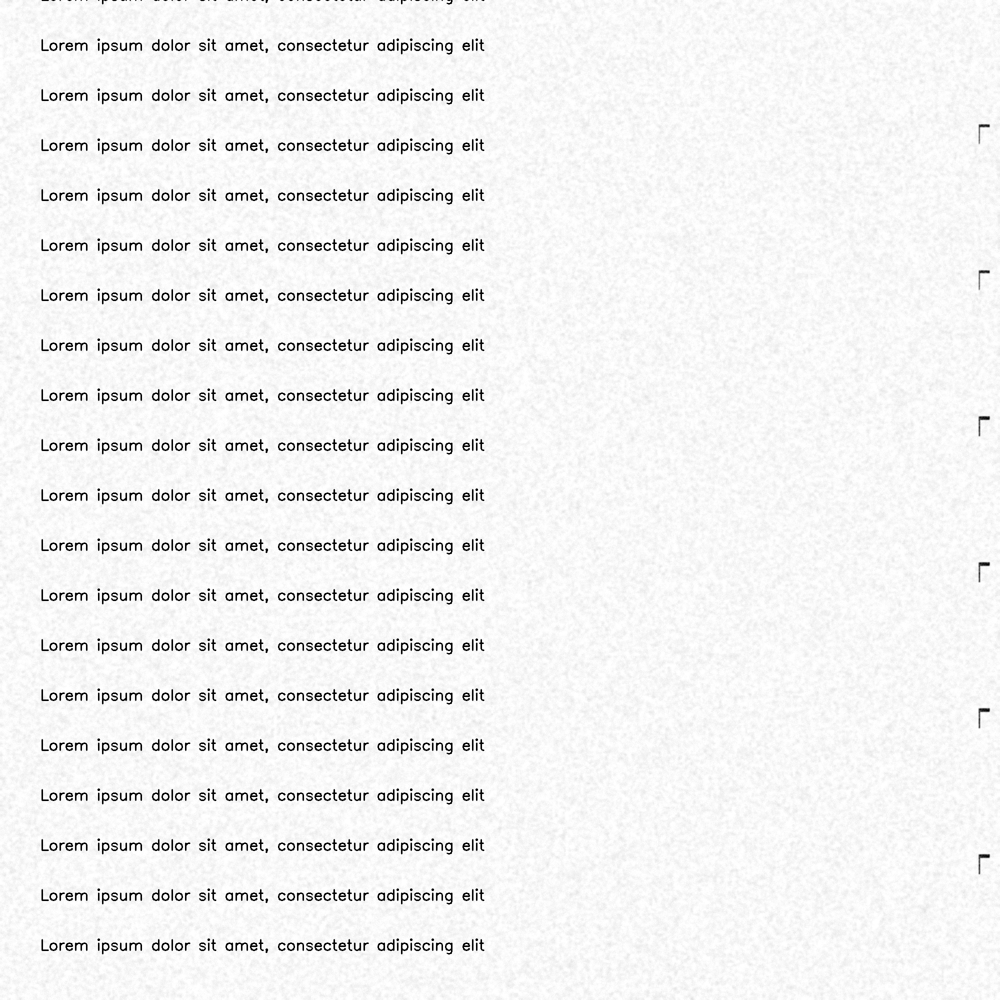

In [ ]:
# 3. Augmentation using batches of images (List).

from augraphy import *

pipeline = default_augraphy_pipeline()

# if input is list, output is list too
image_list = [image, image, image]
image_augmented_list = pipeline(image_list)

# display image
cv2_imshow(image_augmented_list[0])

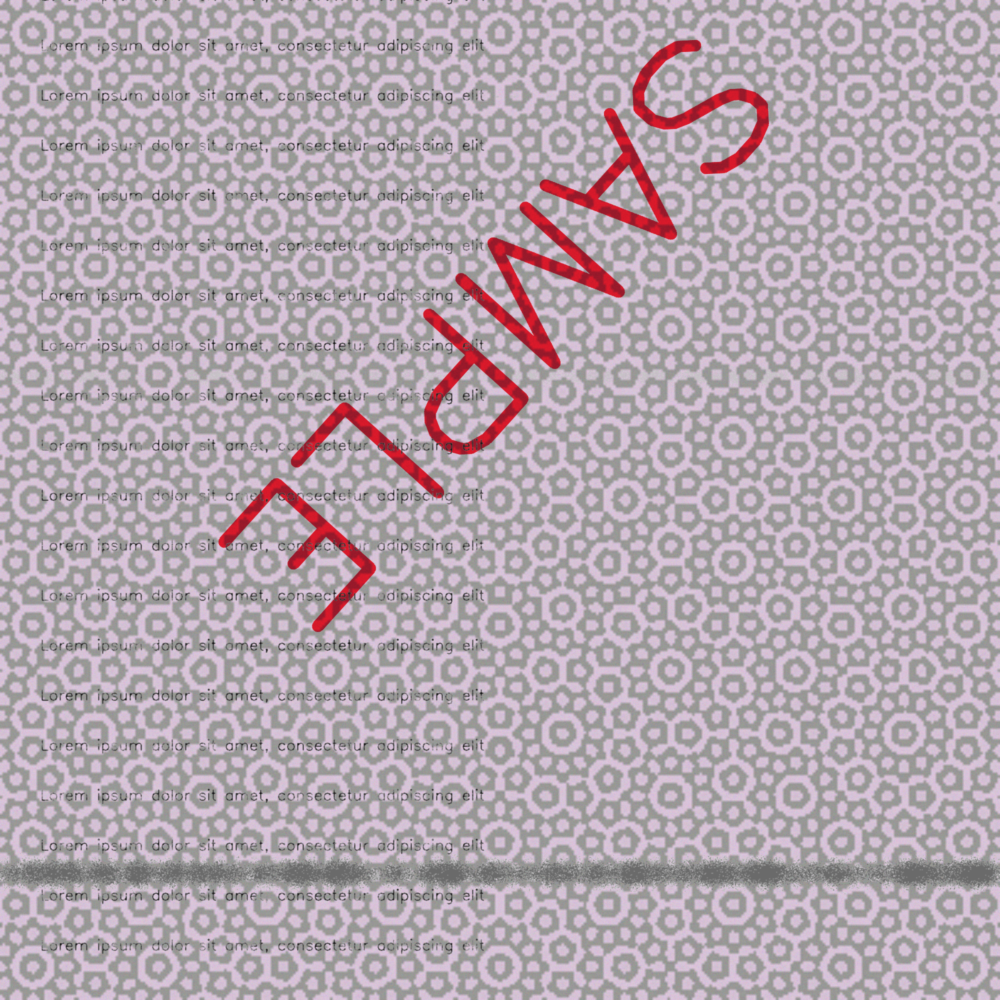

In [ ]:
# 4. Augmentation using batches of images (4D numpy array).

from augraphy import *

pipeline = default_augraphy_pipeline()

# (batch size, channel, height, width)
height, width, channels = image.shape
image_4D = np.zeros((2, channels, height, width),dtype=image.dtype)
image_4D[0] = image.reshape(channels, height, width)
image_4D[1] = image.reshape(channels, height, width)
# if input is 4D array, output is 4D array too
image_augmented_4D = pipeline(image_4D)


# display image
# reshape and convert back to 2D image
cv2_imshow(image_augmented_4D[0].reshape(height, width, channels))

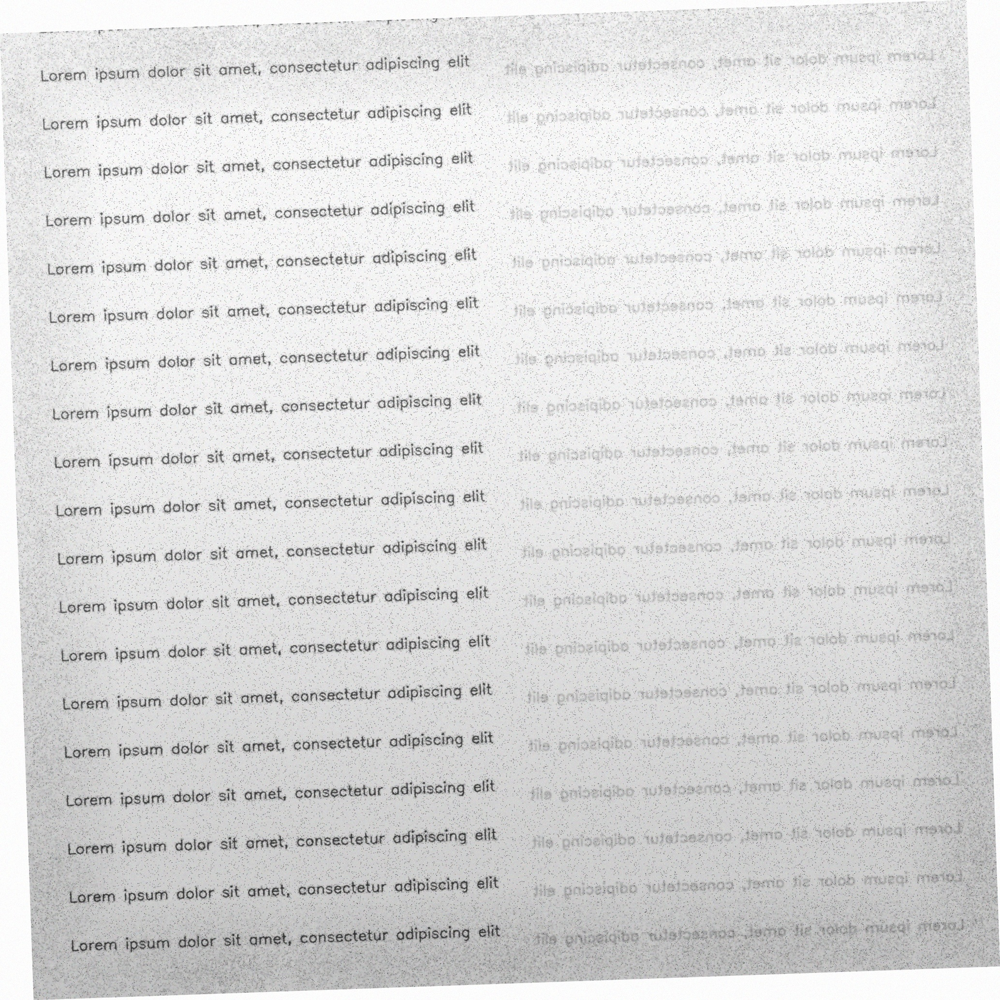

In [ ]:
# 5. Augmentation using archetype pipelines (predefined pipeline). There are 10 predefined pipelines now.

from augraphy import *
from augraphy.default.pipeline import *

pipeline = pipeline_archetype3()

image_augmented = pipeline(image)

# display image
cv2_imshow(image_augmented)

input image


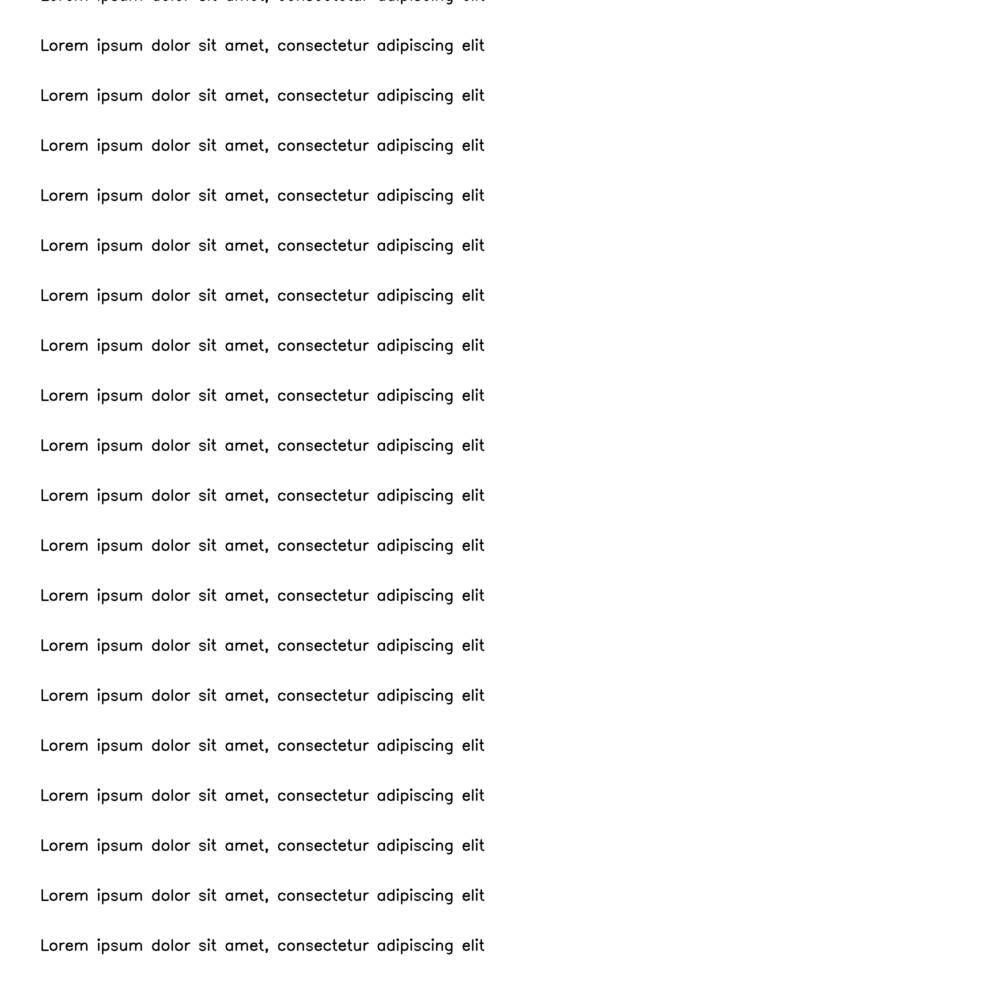

augmented image


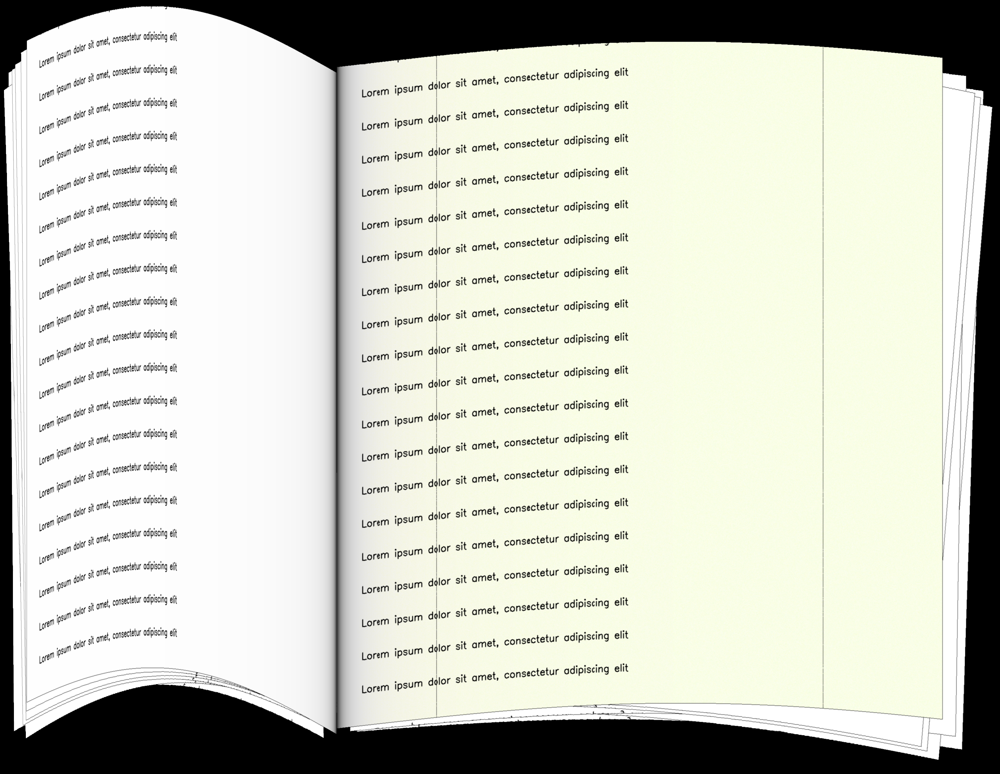

input mask


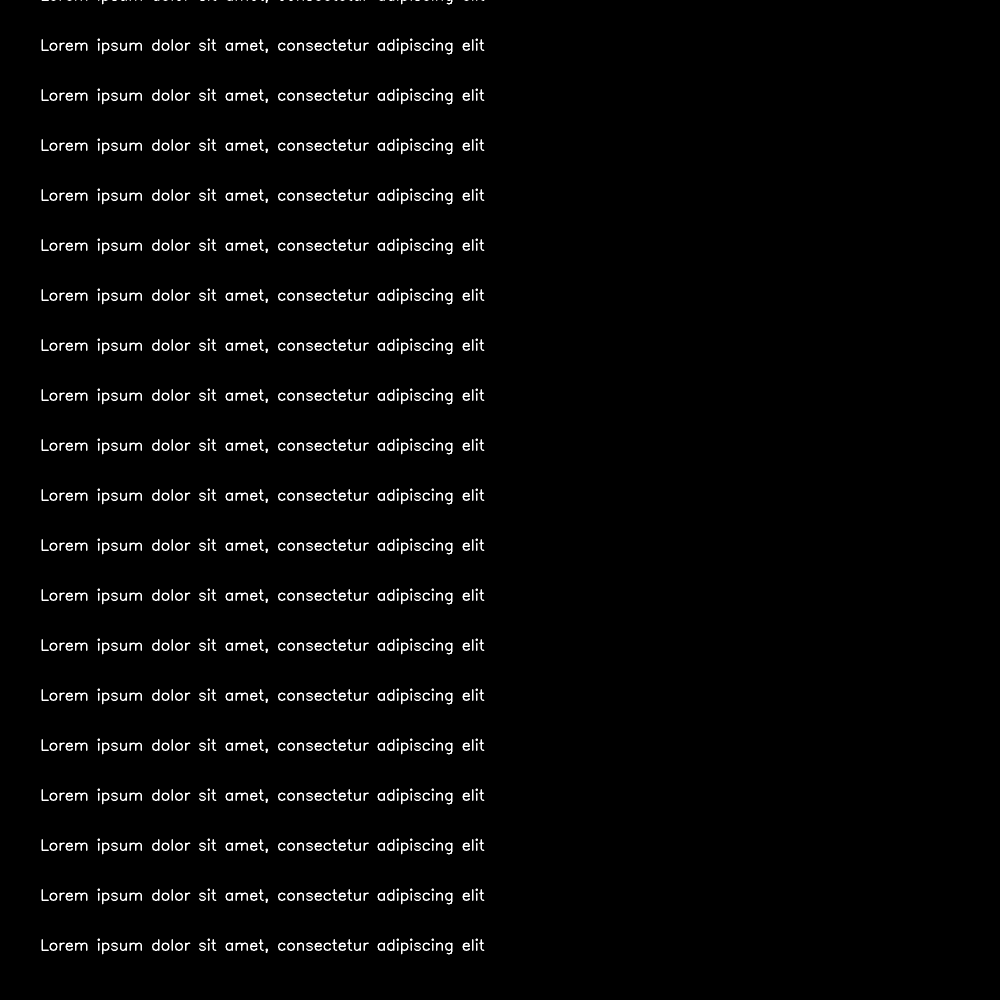

augmented mask


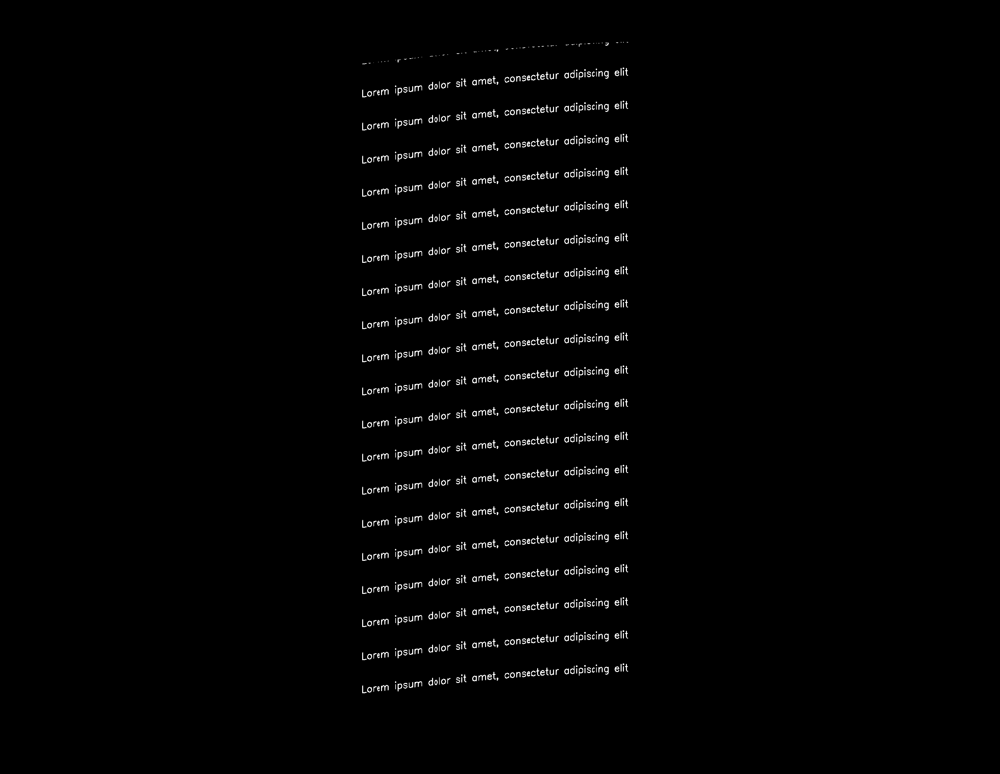

input keypoints


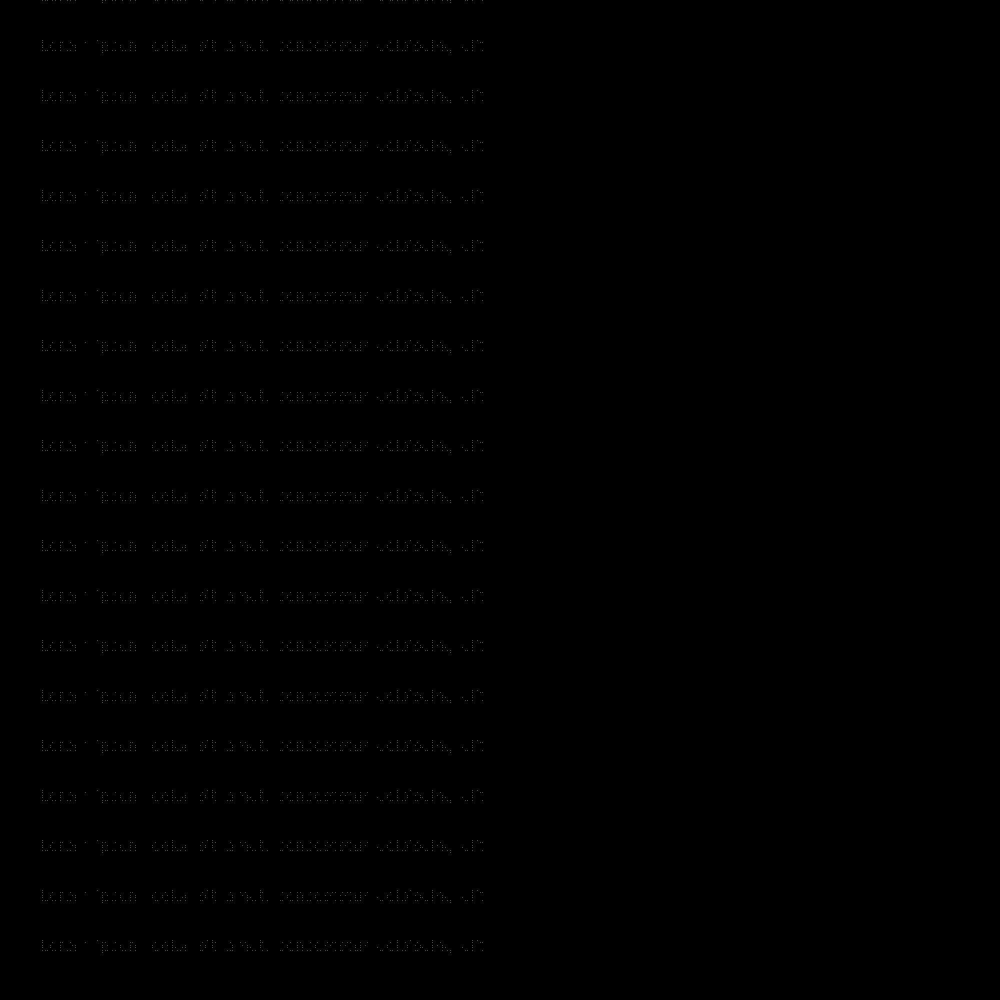

augmented keypoints


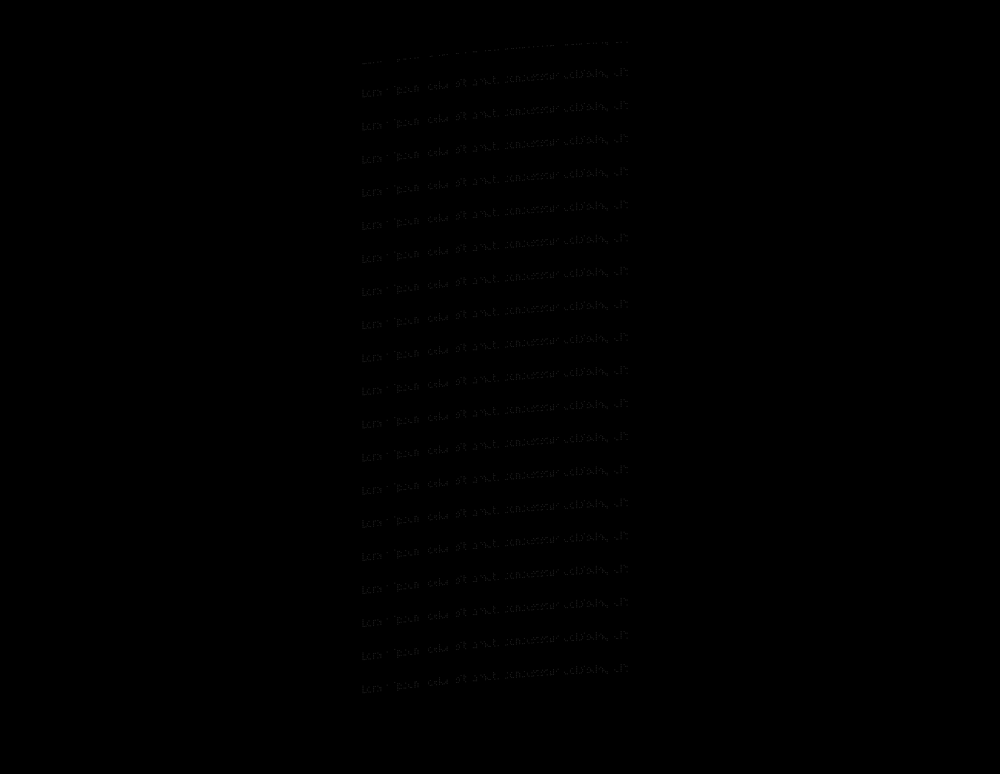

input bounding boxes


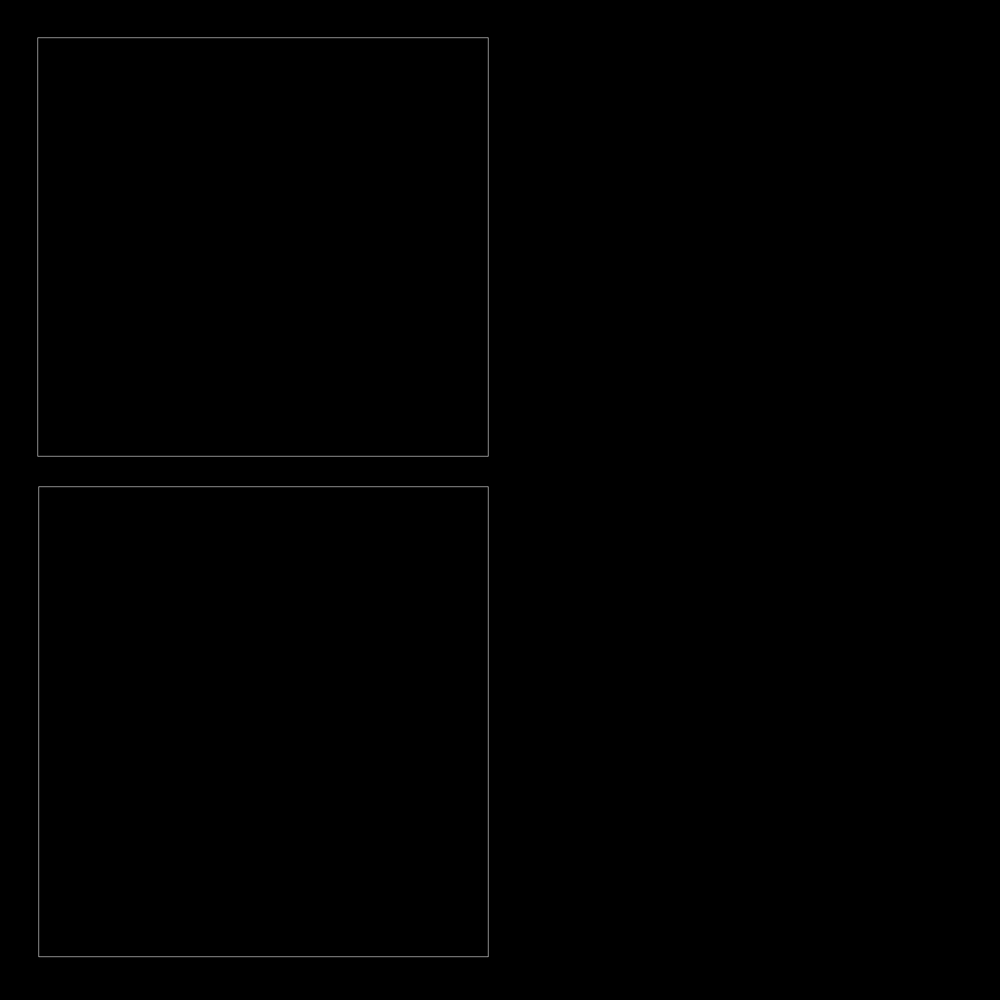

augmented bounding boxes


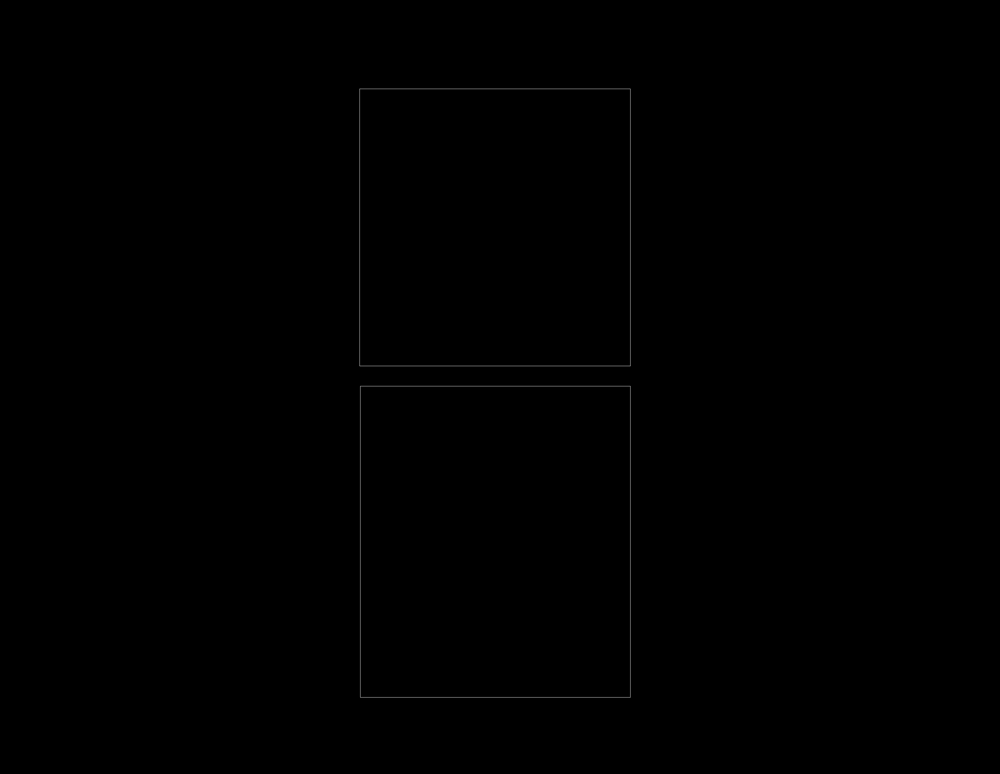

In [12]:
# 6. Augmentation with additional inputs such as mask, keypoints and bounding boxes.

from augraphy import *

# create an example of mask
mask = np.zeros((image.shape[0], image.shape[1]), dtype="uint8")
mask[image[:,:,0]==0] = 255

# create an example of keypoints
points = []
for y in range(image.shape[0]):
    for x in range(image.shape[1]):
        if np.sum(image[y,x])<5:
            if not y%5:
                if not x%5:
                    points += [[x, y]]
keypoints = {"words":points}

# create an example of bounding boxes
bounding_boxes = [[75, 75, 976, 912],
                  [77, 973, 976, 1913]]

# define augmentation pipeline
ink_phase = [Squish()]
paper_phase = [ColorPaper()]
post_phase = [BookBinding()]
pipeline = AugraphyPipeline(ink_phase=ink_phase, paper_phase=paper_phase, post_phase=post_phase, mask=mask, keypoints=keypoints, bounding_boxes=bounding_boxes)

# augment inputs
image_augmented, mask_augmented, keypoints_augmented, bounding_boxes_augmented = pipeline(image)

# initialize input and output image for keypoints and bounding boxes
image_keypoints = np.zeros((image.shape[0], image.shape[1]), dtype="uint8")
image_bounding_boxes = np.zeros((image.shape[0], image.shape[1]), dtype="uint8")
image_keypoints_augmented = np.zeros((image_augmented.shape[0], image_augmented.shape[1]), dtype="uint8")
image_bounding_boxes_augmented = np.zeros((image_augmented.shape[0], image_augmented.shape[1]), dtype="uint8")

# plot keypoints for visualization purpose
# input
for keypoint in keypoints["words"]:
    image_keypoints[keypoint[1], keypoint[0]] = 255
# output
for keypoint in keypoints_augmented["words"]:
    image_keypoints_augmented[keypoint[1], keypoint[0]] = 255

# plot bounding boxes for visualization purpose
# input
for bounding_box in bounding_boxes:
    cv2.rectangle(image_bounding_boxes, (bounding_box[0],bounding_box[1]), (bounding_box[2],bounding_box[3]), color=(255,255,255), thickness=1)
# output
for bounding_box in bounding_boxes_augmented:
    cv2.rectangle(image_bounding_boxes_augmented, (bounding_box[0],bounding_box[1]), (bounding_box[2],bounding_box[3]), color=(255,255,255), thickness=1)

# display image
print("input image")
cv2_imshow(image)
# display augmented image
print("augmented image")
cv2_imshow(image_augmented)

# display mask
print("input mask")
cv2_imshow(mask)
# display augmented mask
print("augmented mask")
cv2_imshow(mask_augmented)

# display keypoints
print("input keypoints")
cv2_imshow(image_keypoints)
# display augmented keypoints
print("augmented keypoints")
cv2_imshow(image_keypoints_augmented)

# display bounding boxes
print("input bounding boxes")
cv2_imshow(image_bounding_boxes)
# display augmented bounding boxes
print("augmented bounding boxes")
cv2_imshow(image_bounding_boxes_augmented)